In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scipy.io
import scanpy.external as scex
import sklearn.metrics
import seaborn as sns
from matplotlib import pyplot as plt

import sys
sys.path.insert(1, '../mhCompTiss/')

import scanpyHelpers as scH

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
#adata=sc.read(results_file_post)
#adata.uns['log1p'] = {"base":None}

Set up out properties

In [3]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-pac

scanpy==1.9.3 anndata==0.9.1 umap==0.5.3 numpy==1.21.5 scipy==1.7.3 pandas==1.5.3 scikit-learn==1.2.2 statsmodels==0.13.5 python-igraph==0.10.4 pynndescent==0.5.10


/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/umap/umap_.py:660: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()


In [4]:
%matplotlib inline

Set scanpy out-files

In [5]:
writeDir = "write/"

fileName = "pdacMouseMrtx"

resultsFile = writeDir + fileName + '.h5ad'       # final output
resultsFileTotal = writeDir + fileName + 'wImm.h5ad'       # final output
resultsFileQC = writeDir + fileName + '_QC.h5ad'  # post QC (pre-analysis) 

Set figure parameters

In [6]:
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=150, fontsize=10, format='png')
sc.settings.figdir = "figures/" + fileName + "/"
figName = fileName

In [7]:
adata = sc.read(resultsFileQC)
adata

AnnData object with n_obs × n_vars = 16240 × 17519
    obs: 'BFP', 'CLuc', 'CreER', 'DTR', 'EGFP', 'GLuc', 'luciferase', 'mScarlet', 'tdTomato', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'pct_counts_mt', 'most_likely_hypothesis', 'cluster_feature', 'negative_hypothesis_probability', 'singlet_hypothesis_probability', 'doublet_hypothesis_probability', 'Classification', 'GMM', 'treatment'

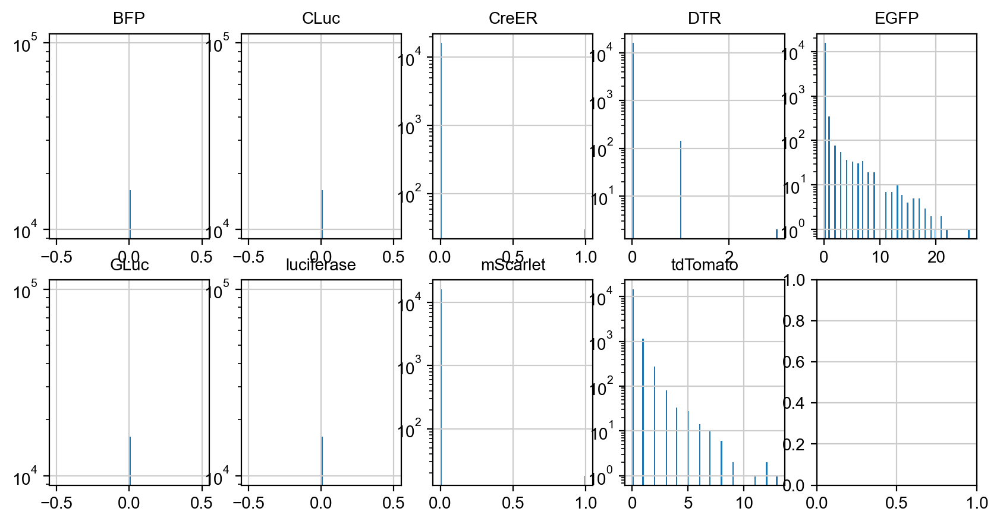

In [8]:
geneMark = ['BFP', 'CLuc', 'CreER', 'DTR', 'EGFP', 'GLuc', 'luciferase', 'mScarlet', 'tdTomato']
plotDim = 5

fig, axs = plt.subplots((len(geneMark)+1)//plotDim, plotDim, figsize=(10, 5))

for i,gene in enumerate(geneMark):
    x,y = i//plotDim, i%plotDim
    axs[x,y].hist(adata.obs[gene], bins=100, log=True)
    axs[x,y].set_title(gene)

In [9]:
adata.obs.GMM.cat.categories

Index(['AK1654_VEH_B0307', 'AK1656_VEH_B0308', 'AK1660_VEH_B0309',
       'AK1661_MRTX_B0303', 'AK1662_MRTX_B0304', 'AK1664_MRTX_B0305',
       'Doublet', 'Negative'],
      dtype='object')

In [10]:
hashNames = ['AK1654_VEH_B0307', 'AK1656_VEH_B0308', 'AK1660_VEH_B0309',
       'AK1661_MRTX_B0303', 'AK1662_MRTX_B0304', 'AK1664_MRTX_B0305',"Negative"]
singlets = [x in hashNames for x in adata.obs["GMM"] ]
adata = adata[singlets,]

In [11]:
#sc.pp.normalize_total(adata,target_sum=1e4)

In [12]:
#sc.pp.log1p(adata)

In [13]:
sc.pp.highly_variable_genes(adata, batch_key="treatment")#, flavor = "seurat", n_top_genes=2000)

extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/preprocessing/_highly_variable_genes.py:540: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['hvg'] = {'flavor': flavor}


extracting highly variable genes
    finished (0:00:01)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
1780


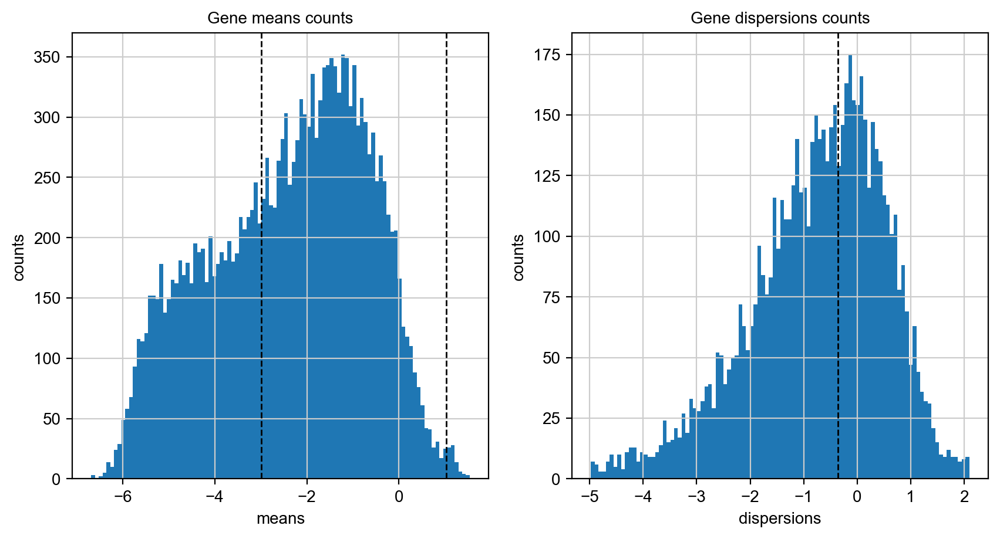

In [14]:
minMean = 0.05
maxMean = 2.8
minDisp = 0.7

fig, axs = plt.subplots(1, 2, figsize=(10, 5))

means = adata.var[["means"]][adata.var[["means"]] > np.exp(-14)]#adata.var[["means"]],
axs[0].hist(np.log(means), bins=100)#, log=True),
axs[0].axvline(np.log(minMean), color='k', linestyle='dashed', linewidth=1)
axs[0].axvline(np.log(maxMean), color='k', linestyle='dashed', linewidth=1)
axs[0].set_title('Gene means counts')
axs[0].set_xlabel('means')
axs[0].set_ylabel('counts')

dispNorm = adata.var[["dispersions_norm"]][adata.var[["dispersions_norm"]] > np.exp(-5)]#adata.var[["means"]],
axs[1].hist(np.log(dispNorm), bins=100)#, log=True),
axs[1].axvline(np.log(minDisp), color='k', linestyle='dashed', linewidth=1)
axs[1].set_title('Gene dispersions counts')
axs[1].set_xlabel('dispersions')
axs[1].set_ylabel('counts')

sc.pp.highly_variable_genes(adata, min_disp=minDisp, min_mean=minMean, max_mean=maxMean, batch_key="treatment")
print(sum(adata.var.highly_variable))

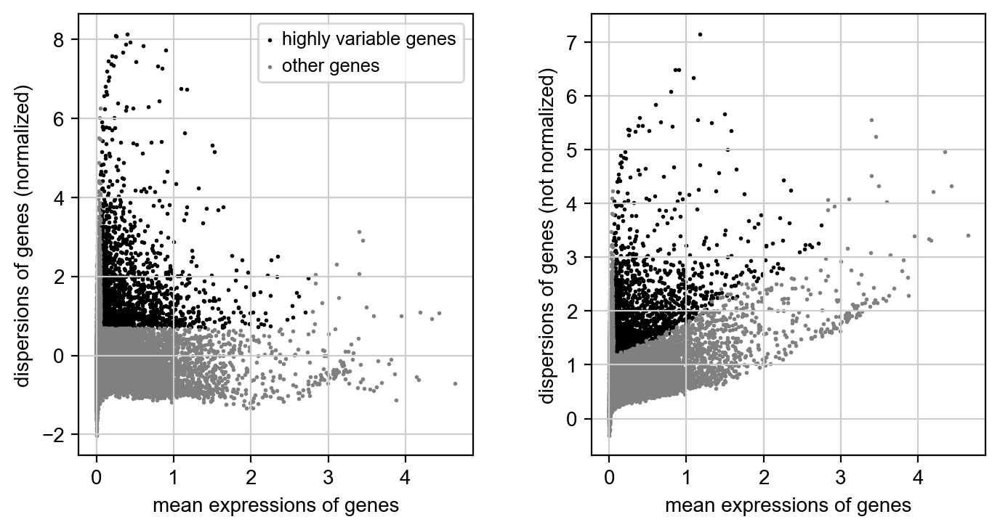

In [15]:
sc.pl.highly_variable_genes(adata)

In [16]:
#for inGene in adata.var[-8:].index.tolist():
#    adata.var.loc[inGene,"highly_variable"] = False

In [17]:
adata.var['mt'] = adata.var_names.str.startswith('mt-') 

In [18]:
adata.raw = adata

In [19]:
#adata = adata[:, adata.var.highly_variable]
adata = adata[:, np.logical_and(adata.var.highly_variable, np.logical_not(adata.var.mt))]

In [20]:
#sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

In [21]:
#sc.pp.scale(adata, max_value=10)

In [22]:
sc.tl.pca(adata, n_comps = 100, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=100
    finished (0:00:02)


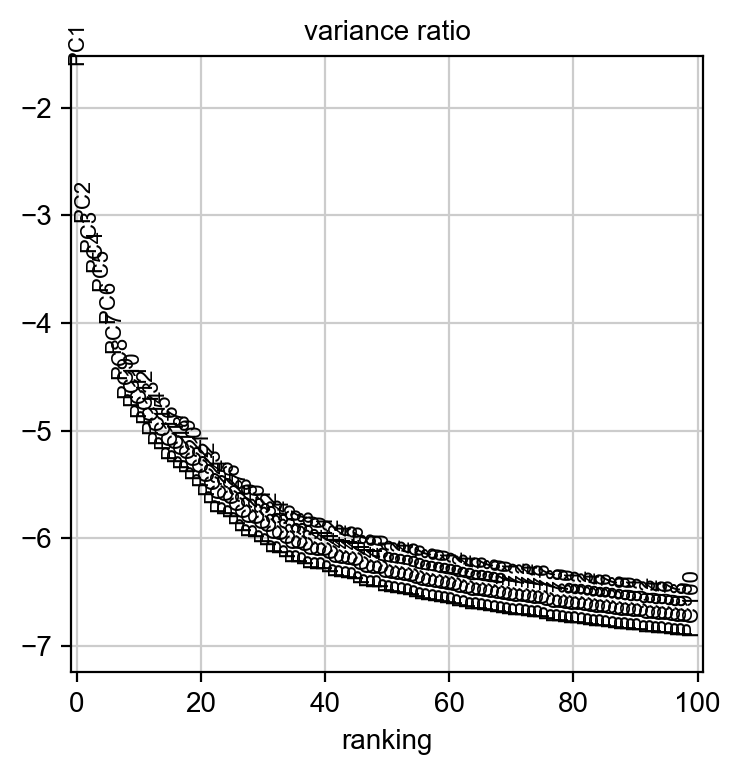

In [23]:
sc.pl.pca_variance_ratio(adata, n_pcs = 100, log=True)

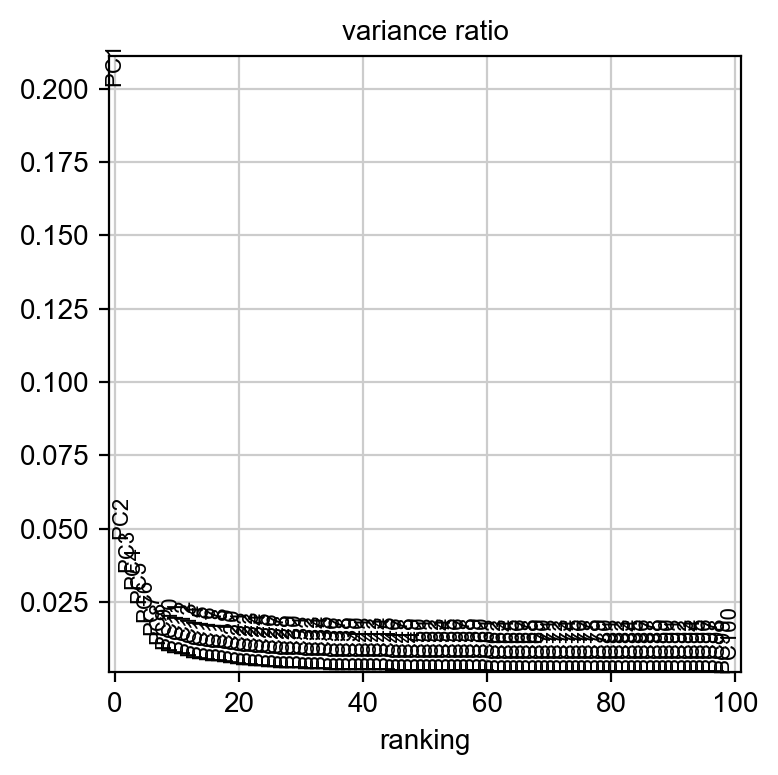

In [24]:
sc.pl.pca_variance_ratio(adata, n_pcs = 100)

In [25]:
sc.pp.neighbors(adata, n_neighbors=20, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:01)


In [26]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)


In [27]:
sc.tl.leiden(adata, resolution=0.2)

running Leiden clustering
    finished: found 11 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


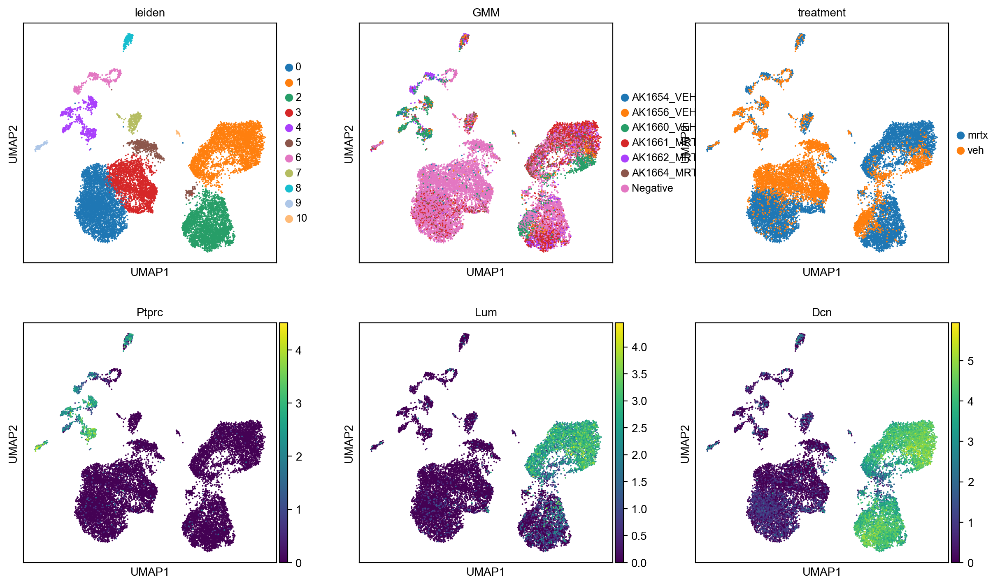

In [28]:
sc.pl.umap(adata, color=["leiden","GMM","treatment","Ptprc","Lum","Dcn"],ncols=3)

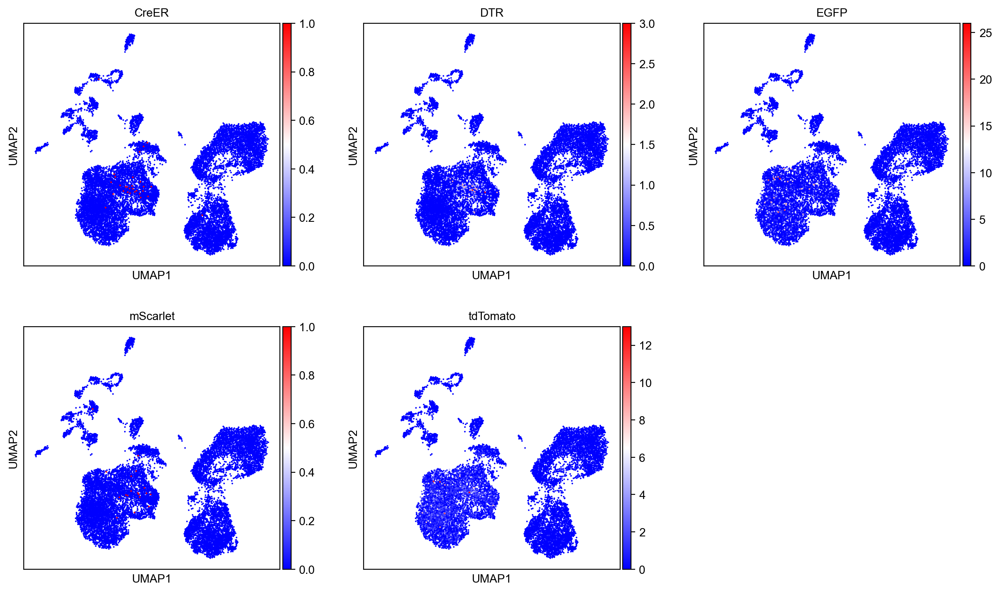

In [29]:
sc.pl.umap(adata, color=['CreER', 'DTR', 'EGFP', 'mScarlet', 'tdTomato'],ncols=3, cmap="bwr")

In [107]:
adata.obs["tdT+"] = ["tdT+" if t > 0.5 else "tdT-" for t in adata.obs.tdTomato] 
adata.obs["EGFP+"] = ["EGFP+" if t > 5 else "EGFP-" for t in adata.obs.EGFP] 
#adata.obs["tumor"] = ["tum" if l in ['2',"8","9"] else "other" for l in adata.obs.leiden]
adata.obs["tumor"] = ["tum" if l in ['0',"3"] else "other" for l in adata.obs.leiden]

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


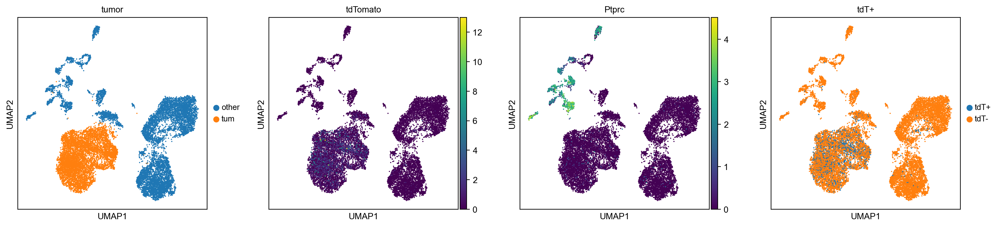

In [108]:
sc.pl.umap(adata, color=["tumor","tdTomato","Ptprc","tdT+"],ncols=4)

In [109]:
sum(adata.obs.tdTomato>0)

1611

In [110]:
sum(adata.obs.tumor=="tum")

6782

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


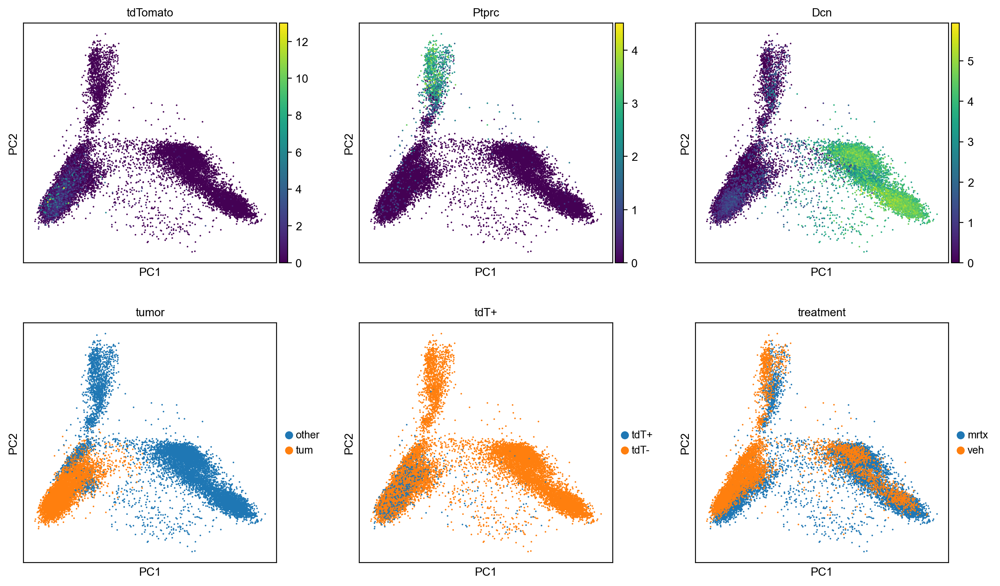

In [188]:
sc.pl.pca(adata, color=["tdTomato","Ptprc","Dcn","tumor","tdT+","treatment"],ncols=3)

In [185]:
#adata.write(resultsFileTotal)
adata = sc.read(resultsFileTotal)


In [113]:
adata = adata[adata.obs.tumor=="tum"]
#adata = adata[adata.obs["tdT+"]=="tdT+"]
adata = adata.raw.to_adata()

In [114]:
sc.pp.highly_variable_genes(adata, batch_key="treatment")#, flavor = "seurat", n_top_genes=2000)

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)
2527
1590


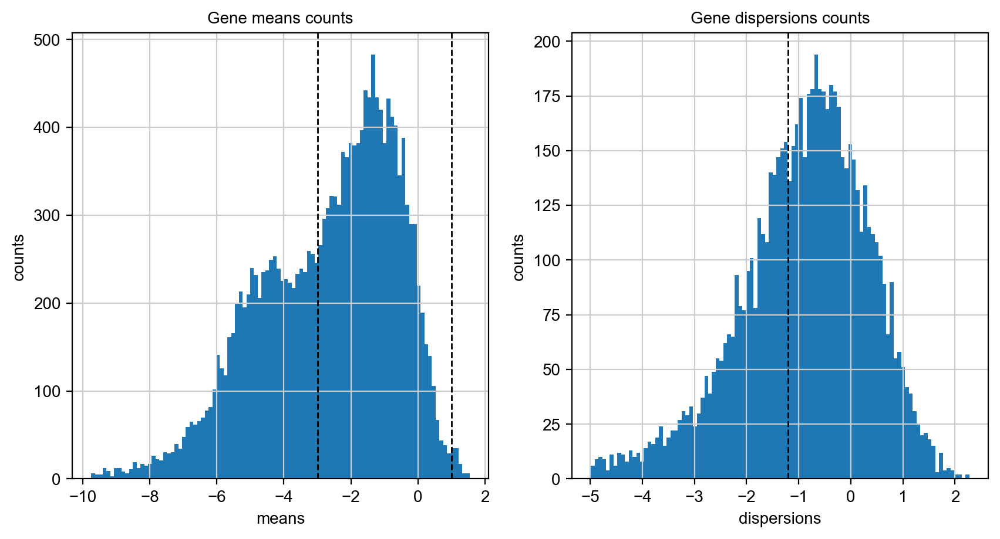

In [115]:
minMean = 0.05
maxMean = 2.7
minDisp = 0.3

fig, axs = plt.subplots(1, 2, figsize=(10, 5))

means = adata.var[["means"]][adata.var[["means"]] > np.exp(-14)]#adata.var[["means"]],
axs[0].hist(np.log(means), bins=100)#, log=True),
axs[0].axvline(np.log(minMean), color='k', linestyle='dashed', linewidth=1)
axs[0].axvline(np.log(maxMean), color='k', linestyle='dashed', linewidth=1)
axs[0].set_title('Gene means counts')
axs[0].set_xlabel('means')
axs[0].set_ylabel('counts')

dispNorm = adata.var[["dispersions_norm"]][adata.var[["dispersions_norm"]] > np.exp(-5)]#adata.var[["means"]],
axs[1].hist(np.log(dispNorm), bins=100)#, log=True),
axs[1].axvline(np.log(minDisp), color='k', linestyle='dashed', linewidth=1)
axs[1].set_title('Gene dispersions counts')
axs[1].set_xlabel('dispersions')
axs[1].set_ylabel('counts')

sc.pp.highly_variable_genes(adata, min_disp=minDisp, min_mean=minMean, max_mean=maxMean, batch_key="treatment")
print(sum(adata.var.highly_variable))
print(sum(adata.var.highly_variable_intersection))

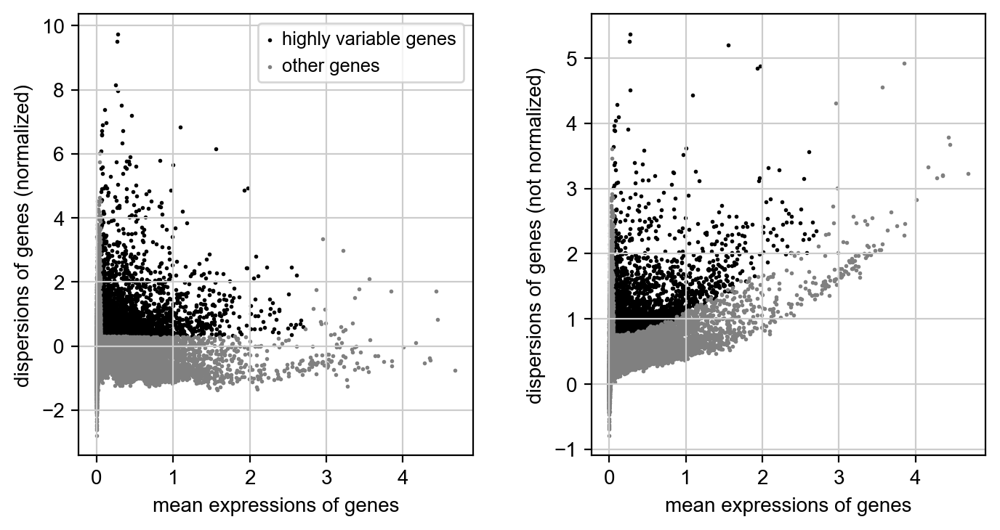

In [116]:
sc.pl.highly_variable_genes(adata)

In [117]:
#for inGene in adata.var[-8:].index.tolist():
#    adata.var.loc[inGene,"highly_variable"] = False

In [118]:
adata.var['mt'] = adata.var_names.str.startswith('mt-') 

In [119]:
adata.raw = adata

In [120]:
#adata = adata[:, adata.var.highly_variable]
#adata = adata[:, np.logical_and(adata.var.highly_variable, np.logical_not(adata.var.mt))]
adata = adata[:, np.logical_and(adata.var.highly_variable_intersection, np.logical_not(adata.var.mt))]

In [121]:
#sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

In [122]:
#sc.pp.scale(adata, max_value=10)

In [123]:
sc.tl.pca(adata, n_comps = 200, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=200
    finished (0:00:03)


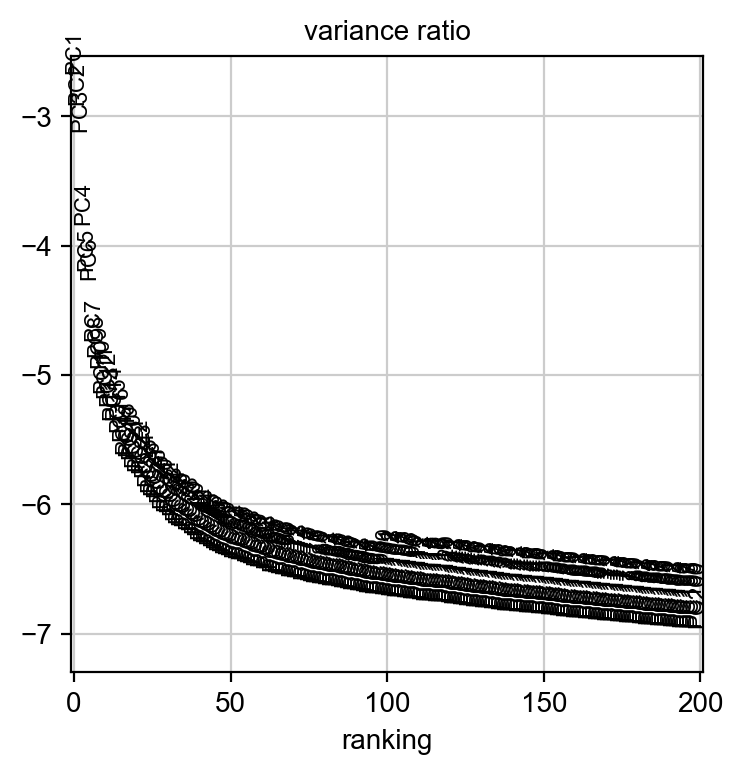

In [124]:
sc.pl.pca_variance_ratio(adata, n_pcs = 200, log=True)

In [125]:
sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


In [126]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)


In [127]:
sc.tl.leiden(adata, resolution=0.25)

running Leiden clustering
    finished: found 6 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


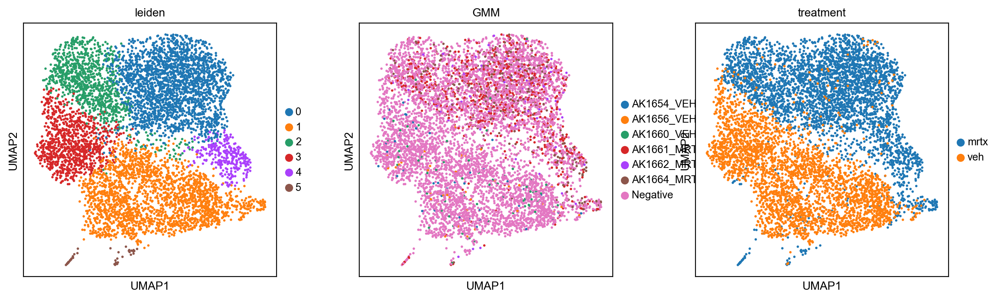

In [128]:
sc.pl.umap(adata, color=["leiden","GMM","treatment"],ncols=3)

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


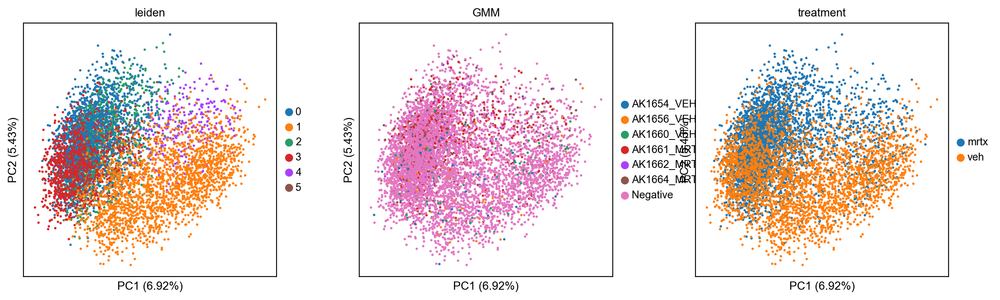

In [129]:
sc.pl.pca(adata, color=["leiden","GMM","treatment"],ncols=3, dimensions= [(0, 1)],annotate_var_explained=True)

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


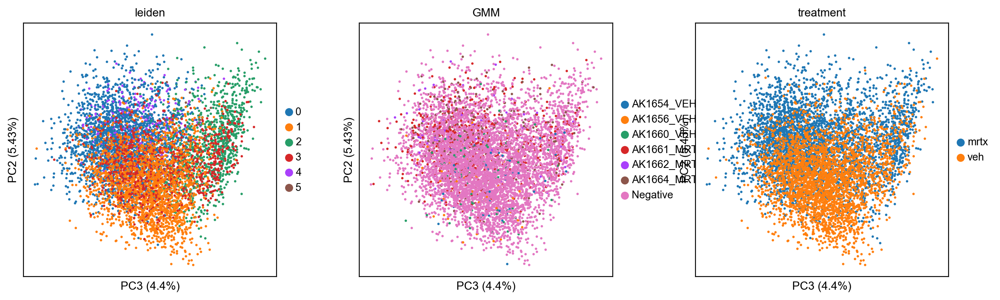

In [130]:
sc.pl.pca(adata, color=["leiden","GMM","treatment"],ncols=3, dimensions= [(2, 1)],annotate_var_explained=True)

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


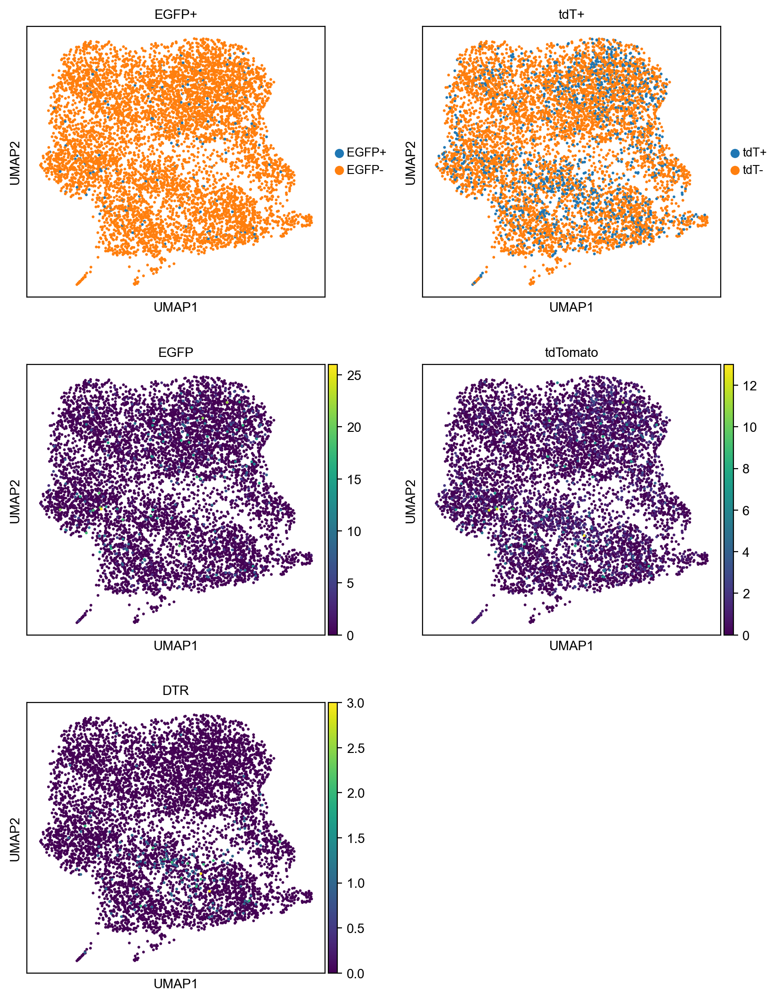

In [131]:
sc.pl.umap(adata, color=['EGFP+', 'tdT+','EGFP', 'tdTomato',"DTR"],ncols=2)#, cmap="bwr")

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning:

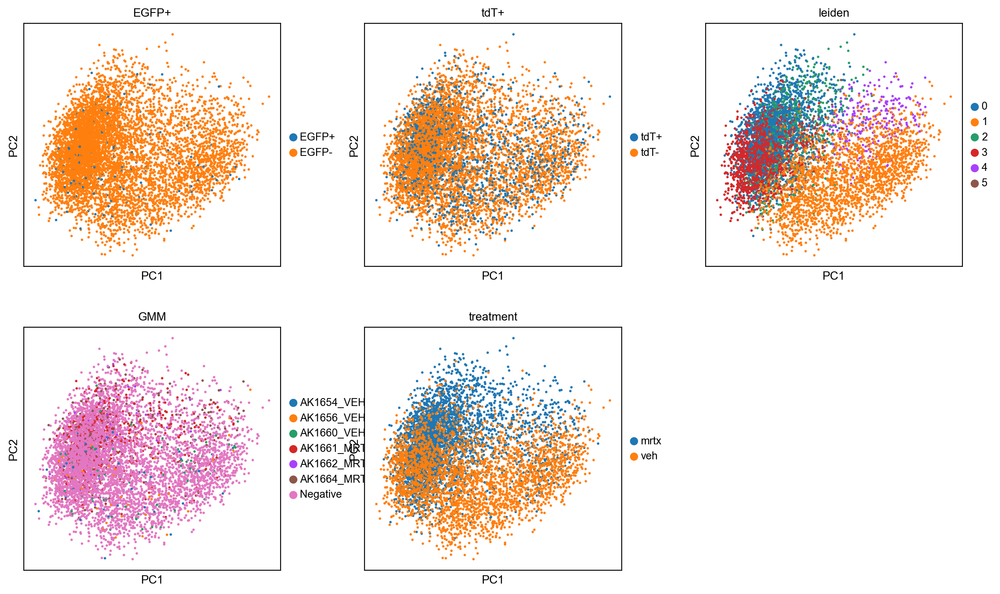

In [132]:
sc.pl.pca(adata, color=['EGFP+', 'tdT+',"leiden","GMM","treatment"],ncols=3)

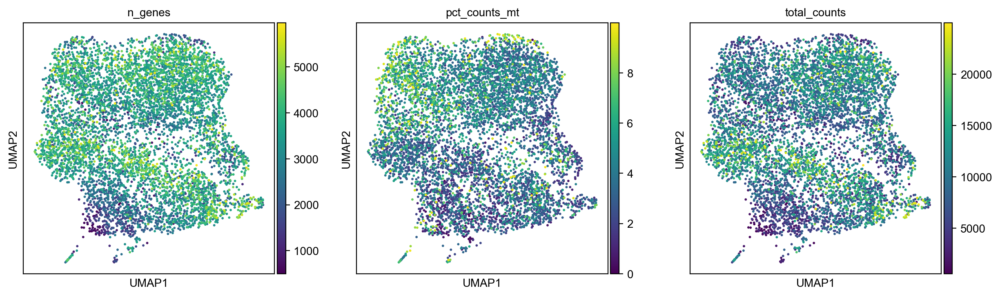

In [133]:
sc.pl.umap(adata, color=["n_genes","pct_counts_mt","total_counts"])

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:00)


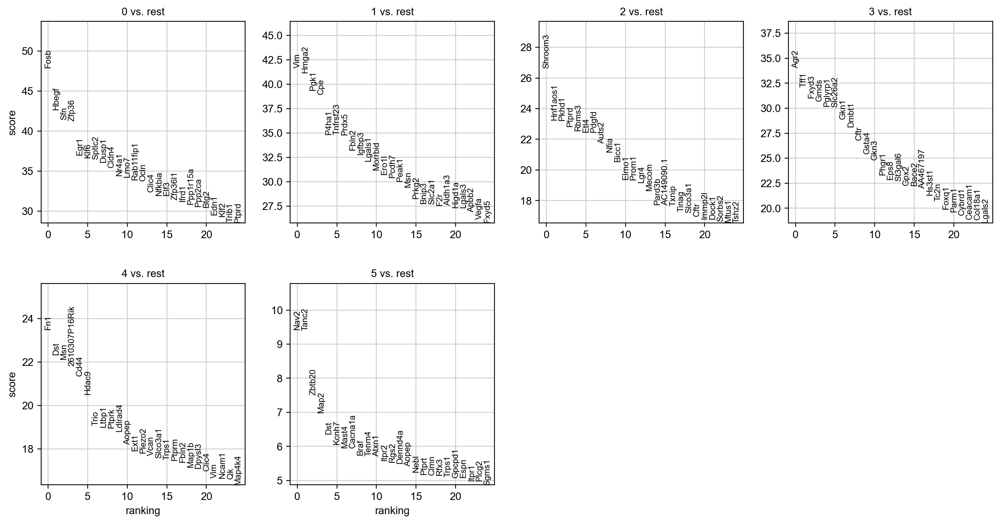

In [134]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon', use_raw=False)
#sc.tl.filter_rank_genes_groups(adata, groupby="leiden", use_raw=False,
#                                   key_added='rank_genes_groups_filtered', 
#                                   min_in_group_fraction=0.25, min_fold_change=1, max_out_group_fraction=0.5, compare_abs=False)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [135]:
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(15)

,0,1,2,3,4,5
0,Fosb,Vim,Shroom3,Agr2,Fn1,Nav2
1,Hbegf,Hmga2,Hnf1aos1,Tff1,Dst,Tanc2
2,Sfn,Pgk1,Pkhd1,Fxyd3,Msn,Zbtb20
3,Zfp36,Cpe,Ptprd,Gmds,2610307P16Rik,Map2
4,Egr1,P4ha1,Rbms3,Pglyrp1,Cd44,Dst
5,Klf6,Tnfrsf23,Etl4,Slc26a2,Hdac9,Kcnh7
6,Sptlc2,Prdx5,Pdgfd,Gkn1,Trio,Mast4
7,Dusp1,Fbln2,Auts2,Dmbt1,Ltbp1,Cacna1a
8,Cldn4,Igfbp3,Nfia,Cftr,Ptprk,Braf
9,Nr4a1,Lgals1,Bicc1,Gsta4,Ldlrad4,Tenm4


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_leiden']`


/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


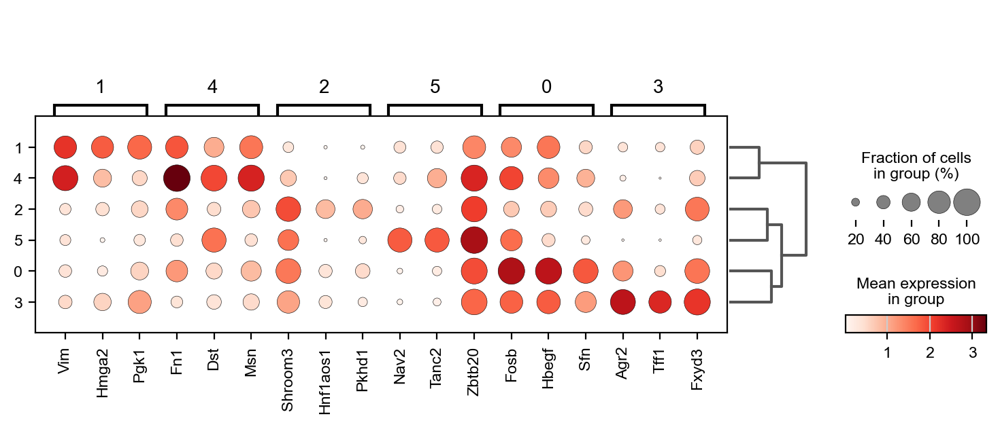

In [136]:
sc.tl.dendrogram(adata,groupby="leiden", n_pcs=50)
sc.pl.rank_genes_groups_dotplot(adata,n_genes=3)#,key="rank_genes_groups_filtered")

In [137]:
resultsFile

'write/pdacMouseMrtx.h5ad'

In [138]:
adata

AnnData object with n_obs × n_vars = 6782 × 1589
    obs: 'BFP', 'CLuc', 'CreER', 'DTR', 'EGFP', 'GLuc', 'luciferase', 'mScarlet', 'tdTomato', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'pct_counts_mt', 'most_likely_hypothesis', 'cluster_feature', 'negative_hypothesis_probability', 'singlet_hypothesis_probability', 'doublet_hypothesis_probability', 'Classification', 'GMM', 'treatment', 'leiden', 'tdT+', 'EGFP+', 'tumor'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'GMM_colors', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'tdT+_colors', 'treatment_colors', 'tumor_colors', 'umap', 'EGFP+_colors', 'rank_genes_groups', 'dendrogram_leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [139]:
adata.write(resultsFile)
adata

AnnData object with n_obs × n_vars = 6782 × 1589
    obs: 'BFP', 'CLuc', 'CreER', 'DTR', 'EGFP', 'GLuc', 'luciferase', 'mScarlet', 'tdTomato', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'pct_counts_mt', 'most_likely_hypothesis', 'cluster_feature', 'negative_hypothesis_probability', 'singlet_hypothesis_probability', 'doublet_hypothesis_probability', 'Classification', 'GMM', 'treatment', 'leiden', 'tdT+', 'EGFP+', 'tumor'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'GMM_colors', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'tdT+_colors', 'treatment_colors', 'tumor_colors', 'umap', 'EGFP+_colors', 'rank_genes_groups', 'dendrogram_leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [140]:
def plotScores(scoreMat, figCols = 4, cutoff = 1.5):
    fig, axs = plt.subplots((len(scoreMat.columns)+1)//figCols, figCols, figsize=(10, 10))
    #sigs = []
    for i,scoreCol in enumerate(scoreMat.columns):
        scoreData = scoreMat[scoreCol]
        x, y = i//figCols, i%figCols
        axs[x, y].hist(((scoreData-np.mean(scoreData))/np.std(scoreData)), bins=100)
        axs[x, y].axvline(cutoff, color='k', linestyle='dashed', linewidth=1)
        axs[x, y].set_title(scoreCol)
        #sigs.append(((scoreData-np.mean(scoreData))/np.std(scoreData)) > cutoff)

    fig.show()
    #return(sigs)
    
def scoreGeneSig(adata, geneSig, translate = False, toGenes=None, fromGenes=None):
    for j,sigName in enumerate(geneSig.columns):
        clustGenes = geneSig.iloc[:,j].dropna()
        if translate:
            for i,mGene in enumerate(clustGenes):
                indexOver = np.where(fromGenes == mGene)[0]
                if indexOver.size > 0:
                    clustGenes[i] = toGenes[indexOver[0]]
        sc.tl.score_genes(adata, clustGenes, score_name=f"{sigName}Score")

def getNewLabels(adata, ogLabels, scoreNames,labelDict):
#   ogLabelScore = pd.DataFrame(np.zeros((len(ogLabels),len(scoreNames))),index=ogLabels, columns=scoreNames)
    ogLabelScoreMe = pd.DataFrame(np.zeros((len(ogLabels),len(scoreNames))),index=ogLabels, columns=scoreNames)
    newBClabel = list(ogLabels.copy())
    
    for score in ogLabelScoreMe.columns:
        scorMe = np.mean(adata.obs[score])
        print(f"\nscore: {scorMe}\n")
        for i,leid in enumerate(ogLabelScoreMe.index):
            adataCat = adata[adata.obs.leiden==leid]
            #ogLabelScore.loc[leid,score] = scorMe
            ogLabelScoreMe.loc[leid,score] = np.round(sum(adataCat.obs[score] > scorMe)/len(adataCat.obs[score]),decimals=4)
    
    print(ogLabelScoreMe)
    
    for i,leid in enumerate(ogLabelScoreMe.index):
        if(np.max(ogLabelScoreMe.loc[leid,:]) > 0.5): # and scorMe > 0
            newBClabel[i] = labelDict[ogLabelScoreMe.columns[np.argmax(ogLabelScoreMe.loc[leid,:])]]
        else:
            newBClabel[i] = "inter"
        
    adata.obs["cellState"] = [newBClabel[int(lei)] for lei in adata.obs.leiden]
    return(newBClabel, ogLabelScoreMe)


def scoreAndLabel(adata, sigGenes, labelOfSigGenes, ogLabel="leiden",translate = False, toGenes=None, fromGenes=None):
    scoreGeneSig(adata, sigGenes, translate = translate, toGenes=toGenes, fromGenes=fromGenes)
    ogLabels = adata.obs[ogLabel].cat.categories
    scoreNames = [f"{sigName}Score" for sigName in sigGenes.columns]
    labelDict = dict(zip(scoreNames,labelOfSigGenes))
    newBClabel, ogLabelScoreMe = getNewLabels(adata, ogLabels, scoreNames, labelDict)
    return(scoreNames, newBClabel, ogLabelScoreMe)

In [141]:
adata = sc.read(resultsFile)

In [142]:
homology = pd.read_table("data/hgncHM_121.csv", sep=",")
mouseGenes = np.array(homology["mouse"])
humanGenes = np.array(homology["human"])
homology

,mouse,human
0,A1bg,A1BG
1,A1cf,A1CF
2,A2m,A2M
3,A3galt2,A3GALT2
4,A4galt,A4GALT
...,...,...
17271,Zyg11a,ZYG11A
17272,Zyg11b,ZYG11B
17273,Zyx,ZYX
17274,Zzef1,ZZEF1


In [143]:
sigGenes = pd.read_csv("data/basClaSigGenes.csv")
sigGenes = sigGenes[["scBasal","scClassical","EMT"]]

In [144]:
#set(sigGenes["basal"]).intersection(set(sigGenes["scBasal"]))

In [145]:
#set(sigGenes["classical"]).intersection(set(sigGenes["scClassical"]))

In [146]:
#set(sigGenes["scBasal"]).intersection(set(sigGenes["EMT"]))

In [147]:
#set(sigGenes["scClassical"]).intersection(set(sigGenes["EMT"]))

computing score 'scBasalScore'
    finished: added
    'scBasalScore', score of gene set (adata.obs).
    1190 total control genes are used. (0:00:00)
computing score 'scClassicalScore'
    finished: added
    'scClassicalScore', score of gene set (adata.obs).
    1190 total control genes are used. (0:00:00)
computing score 'EMTScore'
    finished: added
    'EMTScore', score of gene set (adata.obs).
    1191 total control genes are used. (0:00:00)

score: 0.27435989423543783


score: 0.3600987736766196


score: 0.11400884867682298

   scBasalScore  scClassicalScore  EMTScore
0        0.3392            0.7323    0.4107
1        0.7792            0.1732    0.6379
2        0.1166            0.7236    0.1940
3        0.3333            0.9462    0.0675
4        0.7586            0.0276    0.9345
5        0.0204            0.1020    0.1837


/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


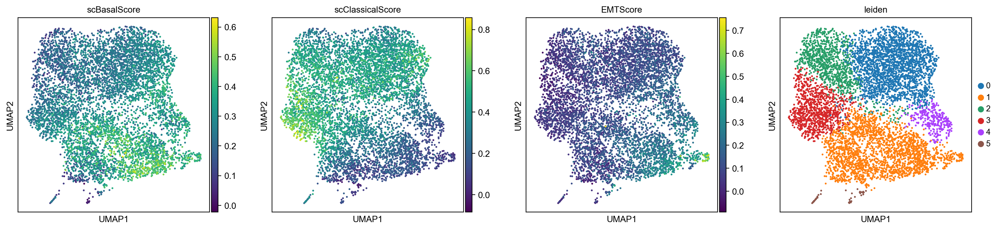

In [148]:
scoreNames, newBClabel, ogLabelScoreMe = scH.scoreAndLabel(adata, sigGenes, 
#                                                            labelOfSigGenes= ["basal","basal","classical","classical","EMT"],
                                                            labelOfSigGenes= ["basal","classical","EMT"],
                                                            ogLabel="leiden",
                                                            translate=True, fromGenes=humanGenes, toGenes=mouseGenes)

sc.pl.umap(adata, color=scoreNames+["leiden"], ncols=4)


/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


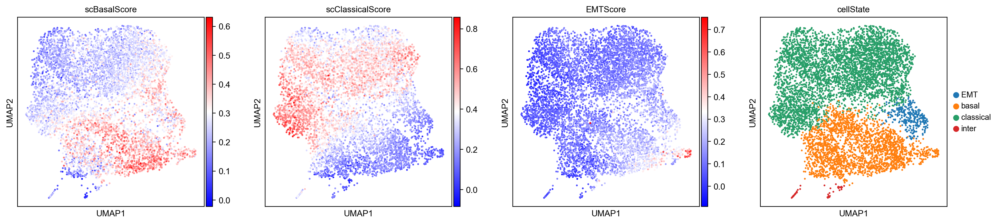

In [149]:
sc.pl.umap(adata, color=scoreNames+["cellState"],ncols=4,cmap="bwr")

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


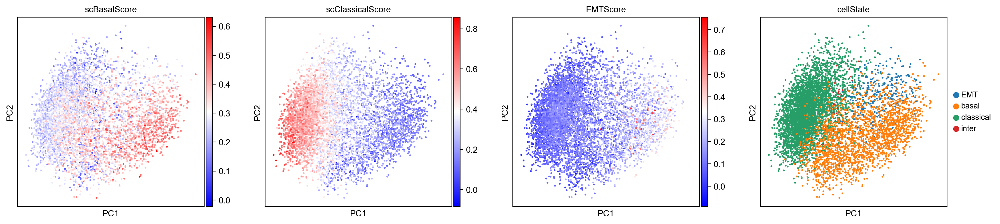

In [190]:
sc.pl.pca(adata, color=scoreNames+["cellState"],ncols=4,cmap="bwr")

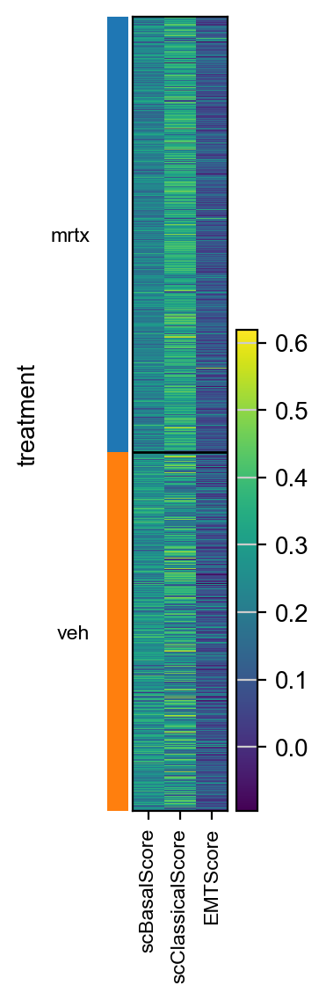

In [151]:
sc.pl.heatmap(adata, scoreNames, groupby="treatment", log=True)

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


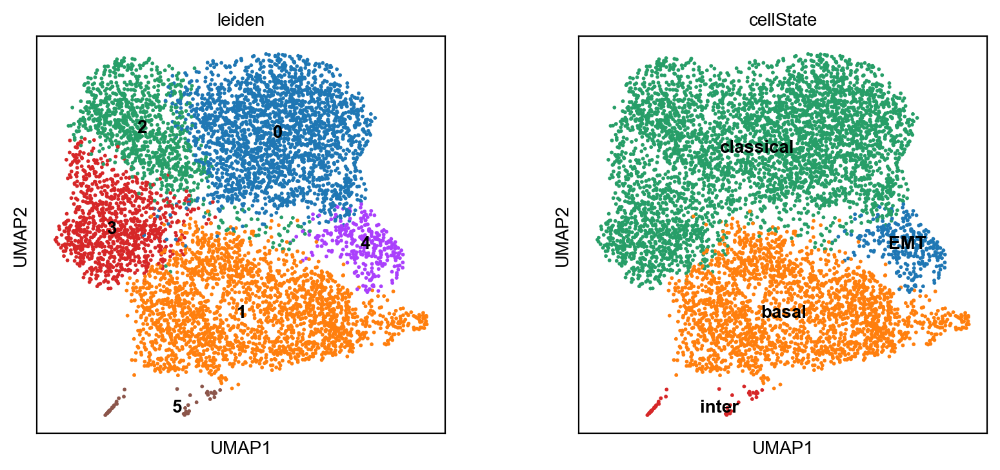

In [152]:
#sc.tl.leiden(adata, resolution=0.2)
sc.pl.umap(adata, color = ["leiden","cellState"], legend_loc="on data")

/var/folders/nc/t9t85q_94q7g4tf0gz83qts40000gn/T/ipykernel_72235/511490758.py:12: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


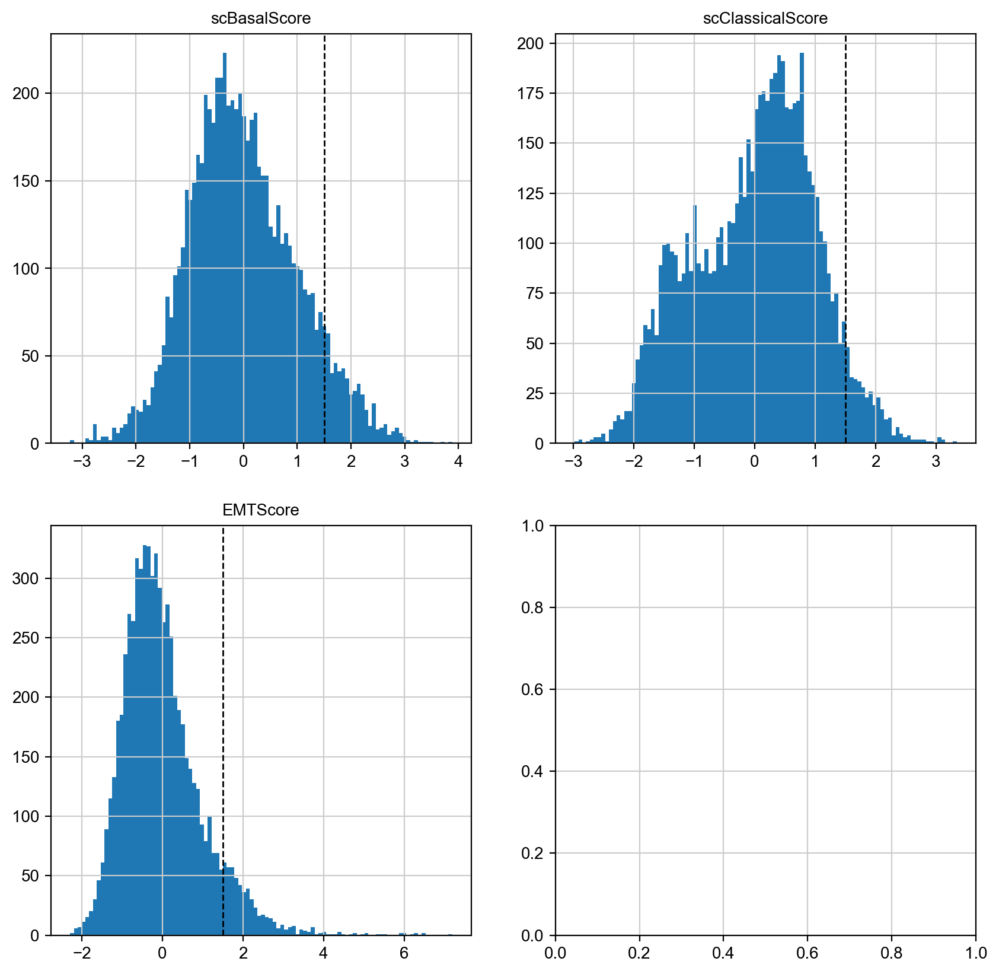

In [153]:
scoreMat = adata.obs[[f"{sigName}Score" for sigName in sigGenes.columns]]

plotScores(scoreMat,figCols = 2)

In [154]:
classLabDict = dict(zip(sigGenes.columns,["basal","classical","EMT"]))#"basal","classical",
markers = pd.DataFrame(np.empty((200*12,2), dtype="object"), columns=["genes", "clustName"])
for i,clust in enumerate(sigGenes.columns):
    for j,gene in enumerate(sigGenes.index):
        gene = sigGenes.loc[gene,clust]
        indexOver = np.where(humanGenes == gene)[0]
        if indexOver.size > 0:
            gene = mouseGenes[indexOver[0]]
        markers.iloc[i*200+j] = gene,classLabDict[clust]
        
markers = markers.dropna()
markers

,genes,clustName
0,KRT6A,basal
1,S100A2,basal
2,Krt13,basal
3,Krt17,basal
4,Ly6d,basal
...,...,...
577,Lum,EMT
578,Mfap5,EMT
579,Sgcg,EMT
580,Efemp2,EMT


In [155]:
markers = markers.drop_duplicates()
markers

,genes,clustName
0,KRT6A,basal
1,S100A2,basal
2,Krt13,basal
3,Krt17,basal
4,Ly6d,basal
...,...,...
577,Lum,EMT
578,Mfap5,EMT
579,Sgcg,EMT
580,Efemp2,EMT


In [156]:
adata

AnnData object with n_obs × n_vars = 6782 × 1589
    obs: 'BFP', 'CLuc', 'CreER', 'DTR', 'EGFP', 'GLuc', 'luciferase', 'mScarlet', 'tdTomato', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'pct_counts_mt', 'most_likely_hypothesis', 'cluster_feature', 'negative_hypothesis_probability', 'singlet_hypothesis_probability', 'doublet_hypothesis_probability', 'Classification', 'GMM', 'treatment', 'leiden', 'tdT+', 'EGFP+', 'tumor', 'scBasalScore', 'scClassicalScore', 'EMTScore', 'cellState'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'EGFP+_colors', 'GMM_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'tdT+_colors', 'treatment_colors', 'tumor_colors', 'umap', 'cellState_colors'
    obsm: 'X_pca',

In [157]:
import decoupler as dc

In [158]:
dc.run_ora(
    mat=adata,
    net=markers,
    source='clustName',
    target='genes',
    min_n=3,
    verbose=True
)

51 features of mat are empty, they will be removed.
Running ora on mat with 6782 samples and 17468 targets for 3 sources.


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 6782/6782 [00:07<00:00, 951.20it/s]


In [159]:
acts = dc.get_acts(adata, obsm_key='ora_estimate')

# We need to remove inf and set them to the maximum value observed for pvals=0
acts_v = acts.X.ravel()
max_e = np.nanmax(acts_v[np.isfinite(acts_v)])
acts.X[~np.isfinite(acts.X)] = max_e

acts

AnnData object with n_obs × n_vars = 6782 × 3
    obs: 'BFP', 'CLuc', 'CreER', 'DTR', 'EGFP', 'GLuc', 'luciferase', 'mScarlet', 'tdTomato', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'pct_counts_mt', 'most_likely_hypothesis', 'cluster_feature', 'negative_hypothesis_probability', 'singlet_hypothesis_probability', 'doublet_hypothesis_probability', 'Classification', 'GMM', 'treatment', 'leiden', 'tdT+', 'EGFP+', 'tumor', 'scBasalScore', 'scClassicalScore', 'EMTScore', 'cellState'
    uns: 'EGFP+_colors', 'GMM_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'tdT+_colors', 'treatment_colors', 'tumor_colors', 'umap', 'cellState_colors'
    obsm: 'X_pca', 'X_umap', 'ora_estimate', 'ora_pvals'

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


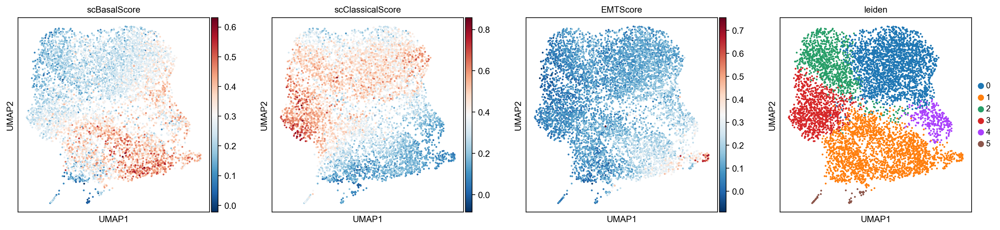

In [160]:
sc.pl.umap(acts, color=scoreNames+['leiden'], cmap='RdBu_r')

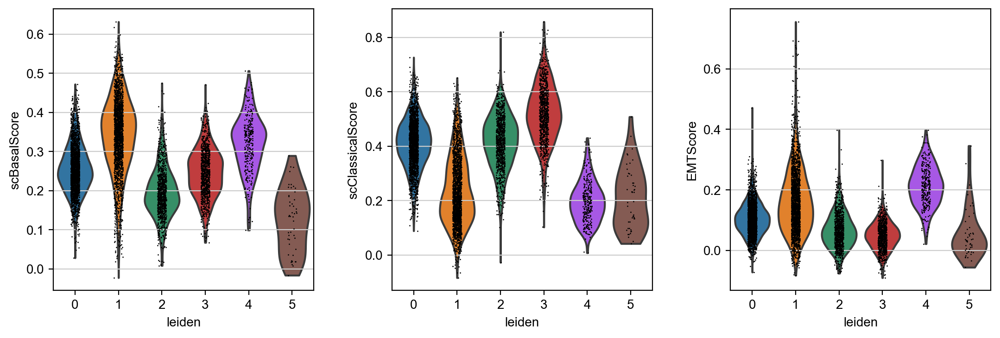

In [161]:
sc.pl.violin(acts, keys=scoreNames, groupby='leiden')

In [162]:
df = dc.rank_sources_groups(acts, groupby='leiden', reference='rest', method='t-test_overestim_var')
df

,group,reference,names,statistic,meanchange,pvals,pvals_adj
0,0,rest,classical,14.709974,2.314857,9.564506e-48,2.869352e-47
1,0,rest,EMT,-10.821120,-0.909968,7.488180e-27,7.488180e-27
2,0,rest,basal,-12.418164,-1.216795,9.422813e-35,1.413422e-34
3,1,rest,basal,35.300812,3.705863,2.226102e-235,3.339153e-235
4,1,rest,EMT,26.444939,2.661034,3.306703e-139,3.306703e-139
5,1,rest,classical,-39.109873,-5.895390,1.756759e-285,5.270276e-285
6,2,rest,classical,4.552036,1.063361,5.671814e-06,5.671814e-06
7,2,rest,EMT,-16.616696,-1.918830,7.963234e-57,1.194485e-56
8,2,rest,basal,-23.459141,-3.178097,1.400453e-105,4.201359e-105
9,3,rest,classical,31.105357,7.691435,1.433914e-171,4.301742e-171


In [163]:
n_ctypes = 3
ctypes_dict = df.groupby('group').head(n_ctypes).groupby('group')['names'].apply(lambda x: list(x)).to_dict()
ctypes_dict

{'0': ['classical', 'EMT', 'basal'],
 '1': ['basal', 'EMT', 'classical'],
 '2': ['classical', 'EMT', 'basal'],
 '3': ['classical', 'basal', 'EMT'],
 '4': ['EMT', 'basal', 'classical'],
 '5': ['EMT', 'classical', 'basal']}

In [164]:
#sc.pl.matrixplot(acts, ctypes_dict, 'leiden', dendrogram=True, standard_scale='var',colorbar_title='Z-scaled scores', cmap='RdBu_r')

In [165]:
annotation_dict = df.groupby('group').head(1).set_index('group')['names'].to_dict()
annotation_dict

{'0': 'classical',
 '1': 'basal',
 '2': 'classical',
 '3': 'classical',
 '4': 'EMT',
 '5': 'EMT'}

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


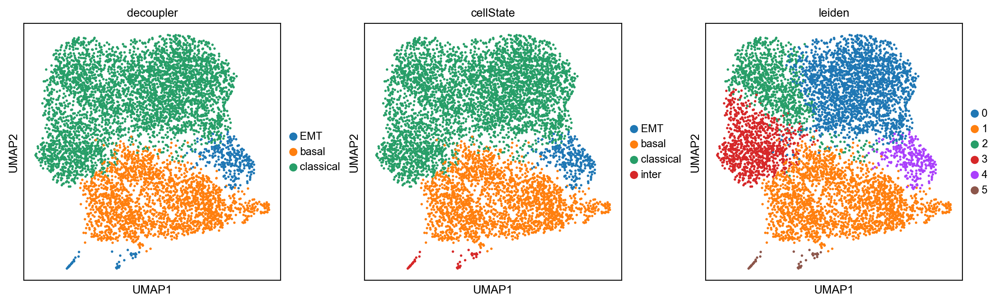

In [166]:
# Add cell type column based on annotation
adata.obs['decoupler'] = [annotation_dict[clust] for clust in adata.obs['leiden']]

# Visualize
sc.pl.umap(adata, color=['decoupler','cellState', "leiden"])

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


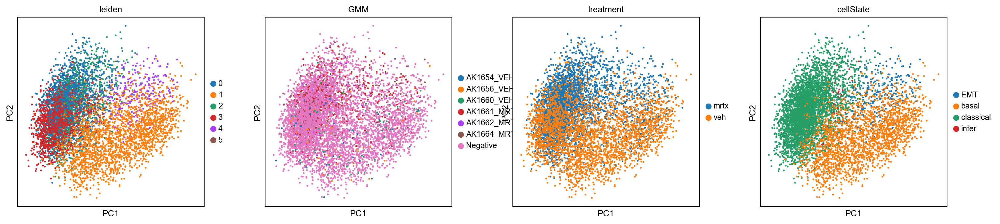

In [167]:
sc.pl.pca(adata, color=["leiden","GMM","treatment","cellState"],ncols=4)

In [168]:
scH.addIndvLabel(adata, [f"{sigName}Score" for sigName in sigGenes.columns], obsLabel="zsig", cutoff=-5)

AnnData object with n_obs × n_vars = 6782 × 1589
    obs: 'BFP', 'CLuc', 'CreER', 'DTR', 'EGFP', 'GLuc', 'luciferase', 'mScarlet', 'tdTomato', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'pct_counts_mt', 'most_likely_hypothesis', 'cluster_feature', 'negative_hypothesis_probability', 'singlet_hypothesis_probability', 'doublet_hypothesis_probability', 'Classification', 'GMM', 'treatment', 'leiden', 'tdT+', 'EGFP+', 'tumor', 'scBasalScore', 'scClassicalScore', 'EMTScore', 'cellState', 'decoupler', 'zsig'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'EGFP+_colors', 'GMM_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'tdT+_colors', 'treatment_colors', 'tumor_colors', 'umap', 'cellState_color

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


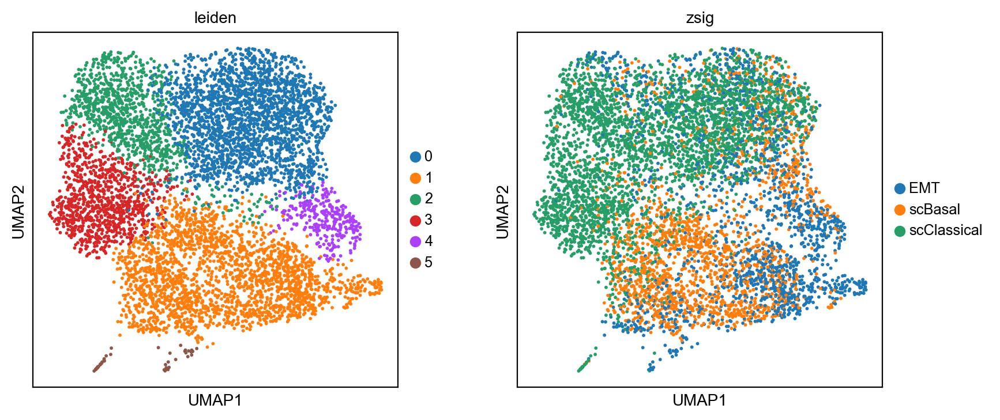

In [169]:
sc.pl.umap(adata, color=["leiden","zsig"])#, legend_loc="on data")

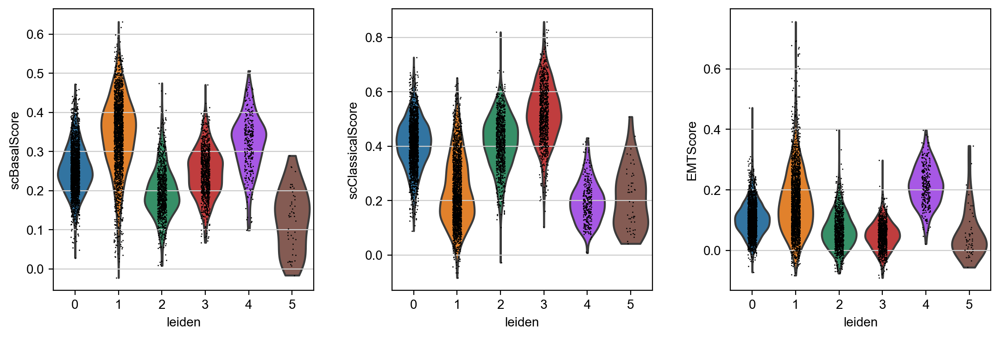

In [170]:
sc.pl.violin(adata, keys=scoreNames, groupby='leiden')

In [171]:
adata.write(resultsFile)
adata

AnnData object with n_obs × n_vars = 6782 × 1589
    obs: 'BFP', 'CLuc', 'CreER', 'DTR', 'EGFP', 'GLuc', 'luciferase', 'mScarlet', 'tdTomato', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'pct_counts_mt', 'most_likely_hypothesis', 'cluster_feature', 'negative_hypothesis_probability', 'singlet_hypothesis_probability', 'doublet_hypothesis_probability', 'Classification', 'GMM', 'treatment', 'leiden', 'tdT+', 'EGFP+', 'tumor', 'scBasalScore', 'scClassicalScore', 'EMTScore', 'cellState', 'decoupler', 'zsig'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'EGFP+_colors', 'GMM_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'tdT+_colors', 'treatment_colors', 'tumor_colors', 'umap', 'cellState_color

In [172]:
resultsFile

'write/pdacMouseMrtx.h5ad'

In [173]:
adata.obs.treatment

AAACCCACATAGAGGC-1-mrtx    mrtx
AAACGAAAGGAGACCT-1-mrtx    mrtx
AAACGAAAGTCTTCGA-1-mrtx    mrtx
AAACGAAAGTGCCGAA-1-mrtx    mrtx
AAACGAACACCTCTAC-1-mrtx    mrtx
                           ... 
TTTGGAGTCAGAGCAG-1-veh      veh
TTTGGTTCATAGAATG-1-veh      veh
TTTGTTGAGGGCCAAT-1-veh      veh
TTTGTTGAGTGTAGAT-1-veh      veh
TTTGTTGGTCATGACT-1-veh      veh
Name: treatment, Length: 6782, dtype: category
Categories (2, object): ['mrtx', 'veh']

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


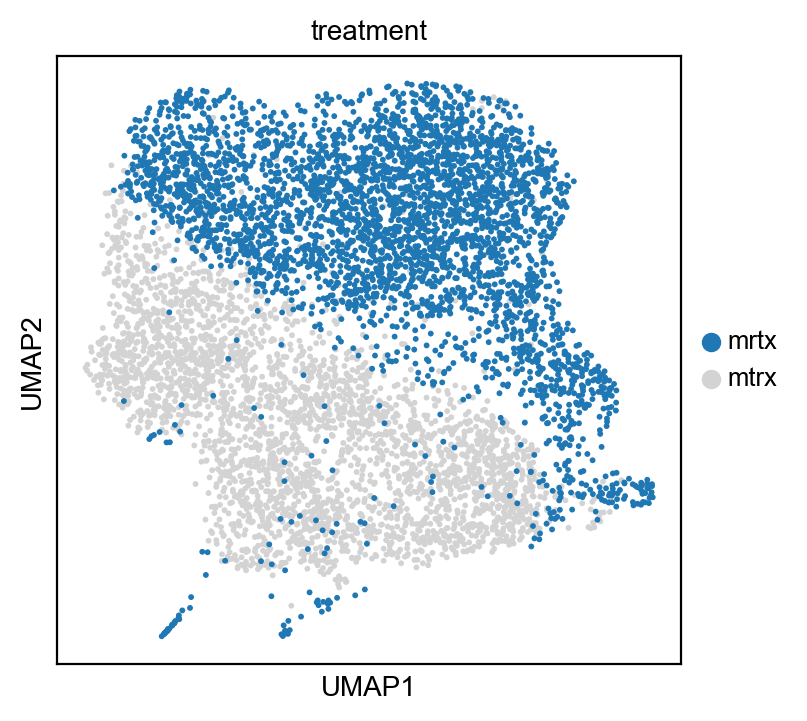

In [174]:
ax=sc.pl.umap(adata,color=['treatment'],groups=['mrtx'], show=False)

# We can change the 'NA' in the legend that represents all cells outside of the
# specified groups
legend_texts=ax.get_legend().get_texts()
# Find legend object whose text is "NA" and change it
for legend_text in legend_texts:
    if legend_text.get_text()=="NA":
        legend_text.set_text('mtrx')

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


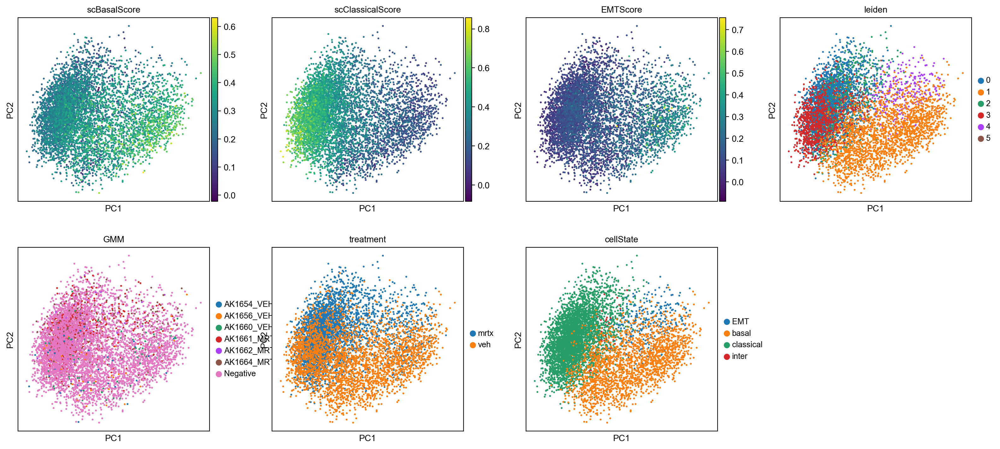

In [175]:
#sc.pl.umap(acts, color=scoreNames+['leiden'], cmap='RdBu_r')
sc.pl.pca(adata, color=scoreNames+["leiden","GMM","treatment","cellState"],ncols=4)

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning:

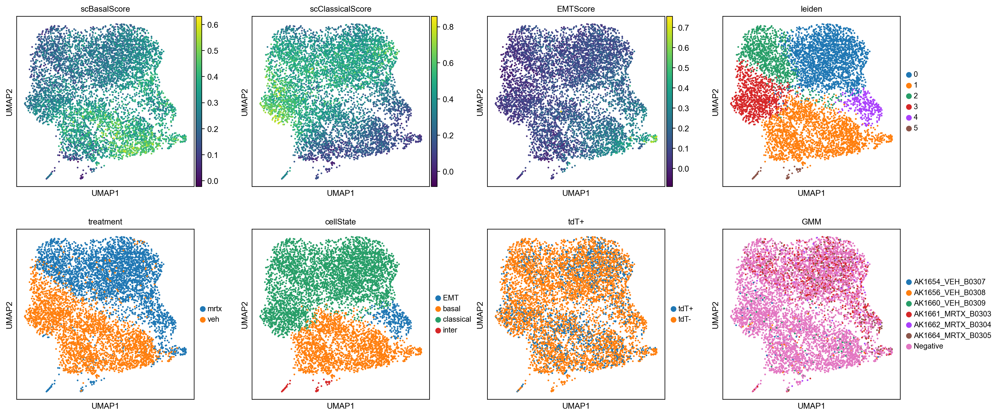

In [176]:
sc.pl.umap(adata, color=scoreNames+["leiden","treatment","cellState","tdT+","GMM"],ncols=4)

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning:

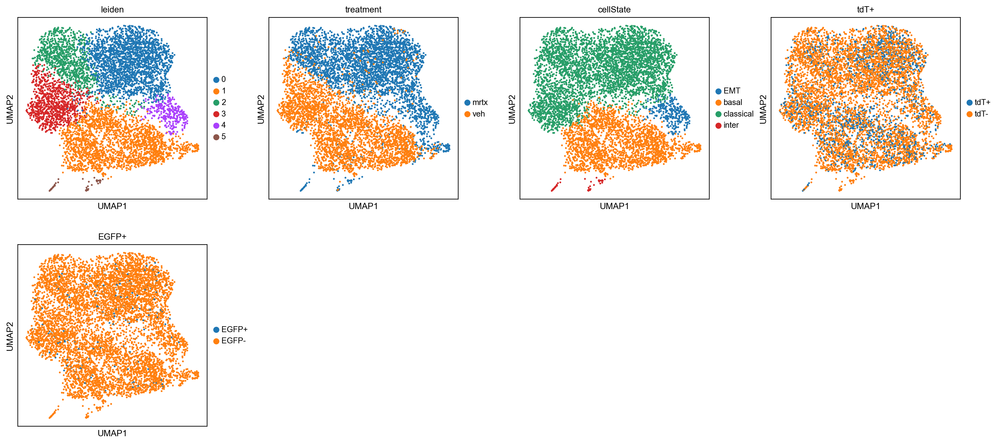

In [177]:
sc.pl.umap(adata, color=["leiden","treatment","cellState","tdT+","EGFP+"],ncols=4)

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning:

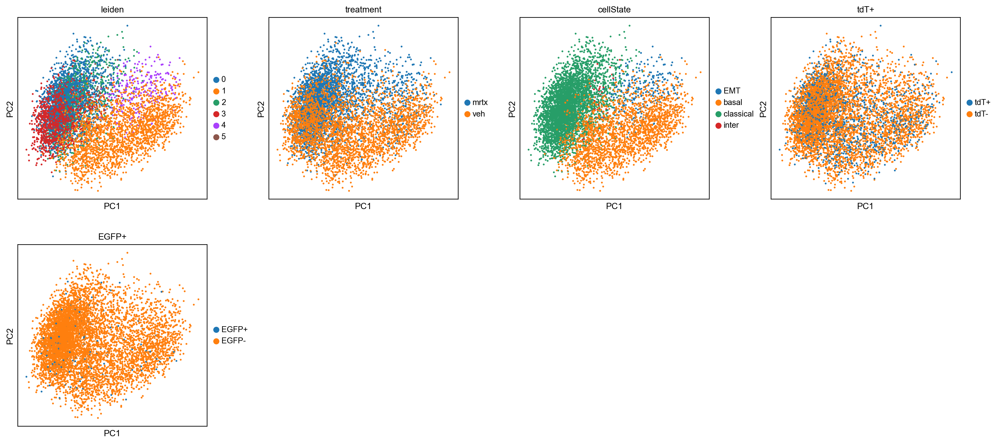

In [178]:
sc.pl.pca(adata, color=["leiden","treatment","cellState","tdT+","EGFP+"],ncols=4)

/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/jonathanrub/miniforge3/envs/scDL/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


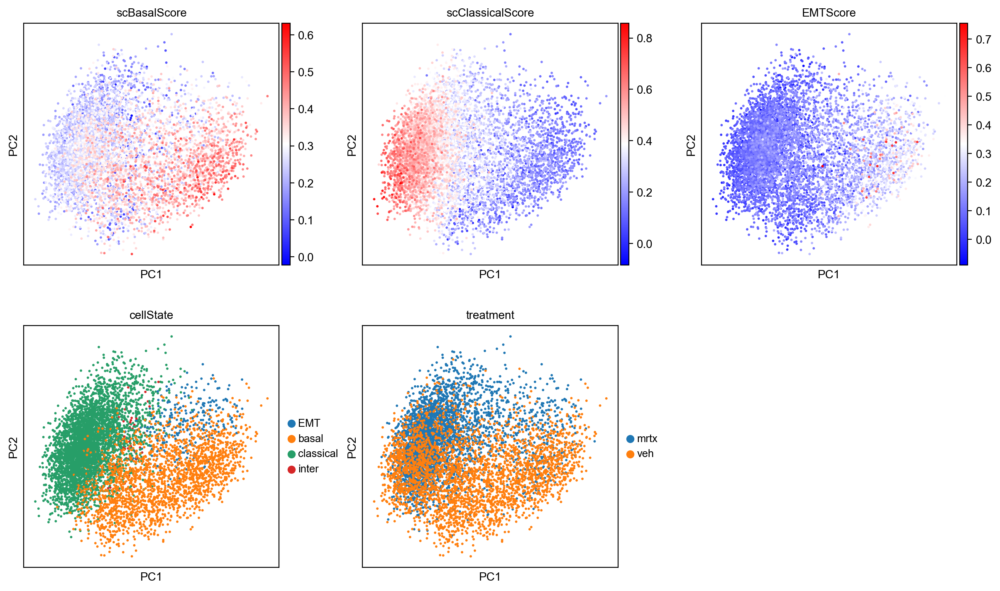

In [192]:
sc.pl.pca(adata, color=scoreNames+["cellState","treatment"],ncols=3,cmap="bwr")

drug treated shoudl have EGFP in only classcial

In [179]:
treatColor = {"veh":1,"mrtx":0}
treatColors = [adata.uns["treatment_colors"][treatColor[i]] for i in adata.obs["treatment"]]

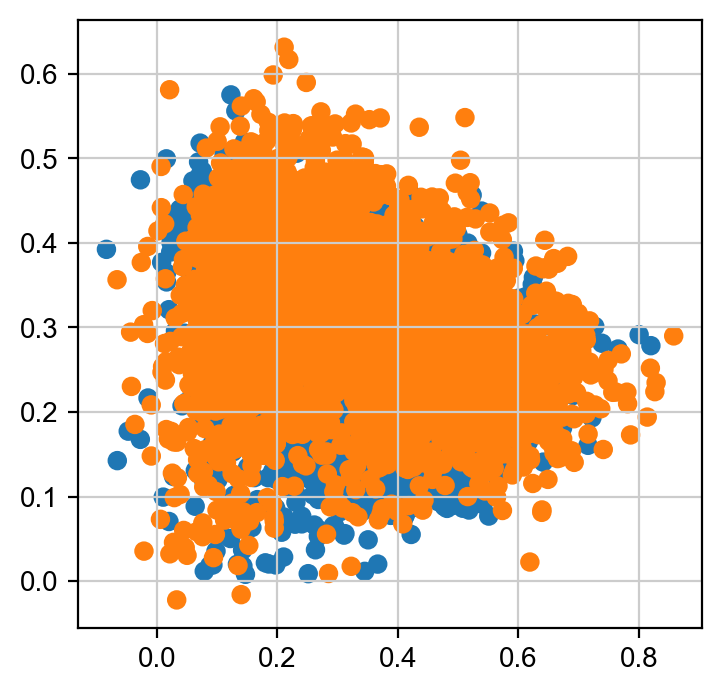

In [180]:
plt.scatter(adata.obs["scClassicalScore"],adata.obs["scBasalScore"], c=treatColors)

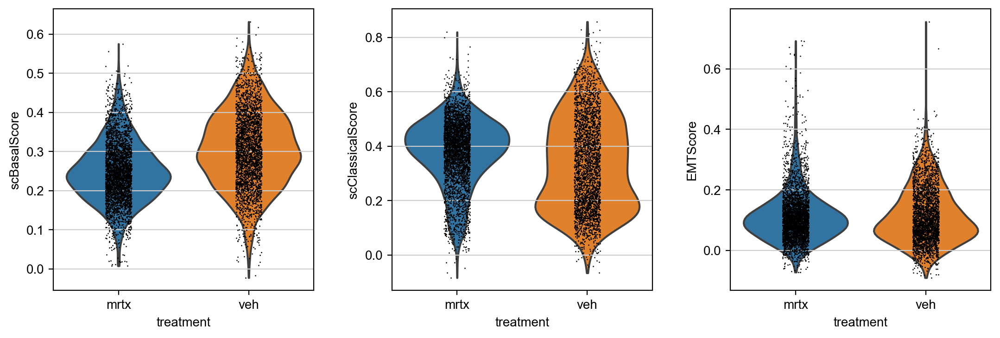

In [181]:
sc.pl.violin(adata, keys=scoreNames, groupby="treatment")

In [182]:
adata.write(resultsFile)

In [7]:
adata = sc.read(resultsFile)

In [25]:
resultsFile

'write/pdacMouseMrtx.h5ad'

In [13]:
from sklearn.metrics.pairwise import cosine_similarity
from scipy import stats

lenPCs = 20

label1 = "mrtxScore"#'scBasalScore'#"S_score"
label2 = "vehScore"#'scClassicalScore'#"G2M_score"

#find pcs pearson correlated with given score
def findDiffPCs(adata, label1, label2=None, lenPCs=20, show=True):
    #intitalize to 0
    #cosSimDif = np.zeros(lenPCs)
    perCorrDif = np.zeros(lenPCs)

    #allCosB = np.zeros(lenPCs)
    #allCosC = np.zeros(lenPCs)

    allCorrB = np.zeros(lenPCs)
    allCorrC = np.zeros(lenPCs)
    
    #if pca hasnt been calcualted calulcate it 
    if("X_pca" not in adata.obsm): 
        sc.tl.pca(adata)
    
    #if given a categorical variable split it into two numbered scores
    if(label2==None):    #if(adata.obs[label1].dtype != float or adata.obs[label1].dtype != int or adata.obs[label2].dtype != float or adata.obs[label2].dtype != int):
        cat1 = adata.obs[label1].cat.categories[0]
        cat2 = adata.obs[label1].cat.categories[1]

        adata.obs[f"{cat1}Score"] = [1 if m==cat1 else 0 for m in adata.obs[label1]]
        adata.obs[f"{cat2}Score"] = [1 if m==cat2 else 0 for m in adata.obs[label1]]
        
        label1 = f"{cat1}Score"
        label2 = f"{cat2}Score"
    
    for i in range(lenPCs):
        #print(f"PC {i+1}")
        #cosB = cosine_similarity(adata.obs[f"{label1}"].values.reshape(1, -1), adata.obsm["X_pca"][:,i].reshape(1, -1))[0][0]
        #cosC = cosine_similarity(adata.obs[f"{label2}"].values.reshape(1, -1), adata.obsm["X_pca"][:,i].reshape(1, -1))[0][0]
        corrB, pval = stats.pearsonr(adata.obs[f"{label1}"].values, adata.obsm["X_pca"][:,i])
        corrC, pval = stats.pearsonr(adata.obs[f"{label2}"].values, adata.obsm["X_pca"][:,i])

        #allCosB[i] = cosB
        #allCosC[i] = cosC

        allCorrB[i] = corrB
        allCorrC[i] = corrC

        #cosSimDif[i] = np.abs(cosB - cosC)
        perCorrDif[i] = np.abs(corrB - corrC)

    #made with the help of chatGPT

    numPCs = len(allCorrB)
    differences = np.abs(allCorrB - allCorrC)
    indSort = np.argsort(differences)

    if(show):
        # Plotting
        plt.figure(figsize=(8, 6))
        bar_width = 0.35

        index = np.arange(1, numPCs+1)
        bars1 = plt.bar(index - bar_width/2, allCorrB, bar_width, color='b', label=label1)

        # Plot Grade 2
        bars2 =plt.bar(index + bar_width/2, allCorrC, bar_width, color='r', label=label2)

        for i in range(len(index)):
            plt.text((index[i] - bar_width/2)+0.2, max(0,max(allCorrB[i], allCorrC[i])) + 0.01, f'{differences[i]:.2f}', ha='center')

        # Highlight the student with the largest difference
        #plt.plot([max_diff_index + 1 - bar_width/2, max_diff_index + 1 + bar_width/2],[allCorrB[max_diff_index], allCorrC[max_diff_index]], 'g--')  

        #bars1[max_diff_index].set_edgecolor('yellow')
        #bars1[max_diff_index].set_linewidth(2)
        #bars2[max_diff_index].set_edgecolor('yellow')
        #bars2[max_diff_index].set_linewidth(2)

        #plt.plot(np.arange(1, numPCs+1), allCorrB, 'bo', label='Basal', markersize=10)  # Plot Grade 1
        #plt.plot(np.arange(1, numPCs+1), allCorrC, 'ro', label='Classical', markersize=10)  # Plot Grade 2
        #plt.plot([max_diff_index + 1] * 2, [allCorrB[max_diff_index], allCorrC[max_diff_index]], 'g--')  # Connect the grades for the student with the largest difference

        # Customizing plot
        plt.title(f'Correlation of PCs with {label1} and {label2}')
        plt.xlabel('PCs')
        plt.ylabel('Pearson Correlation')
        plt.xticks(np.arange(1, numPCs+1))  # Set ticks for each student
        plt.legend()

        plt.grid(True)
        plt.tight_layout()
        plt.show()
    
    return indSort[::-1]

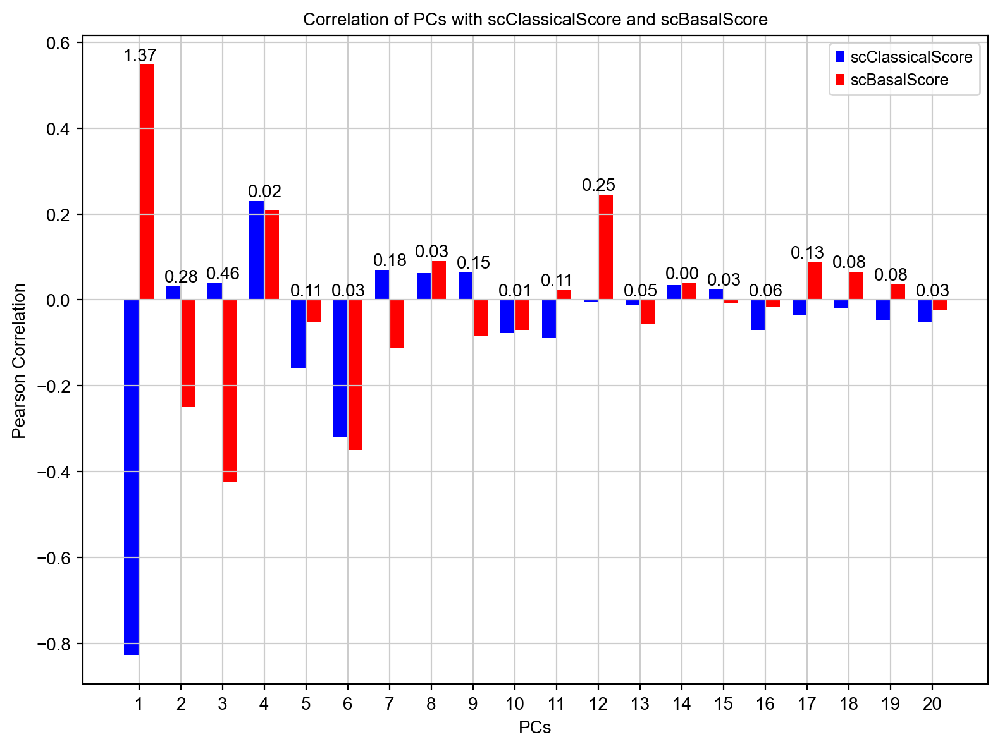

array([ 0,  2,  1, 11,  6,  8, 16, 10,  4, 18, 17, 15, 12, 14,  5, 19,  7,
        3,  9, 13])

In [24]:
findDiffPCs(adata, label1="scClassicalScore", label2="scBasalScore", lenPCs=20, show=True)

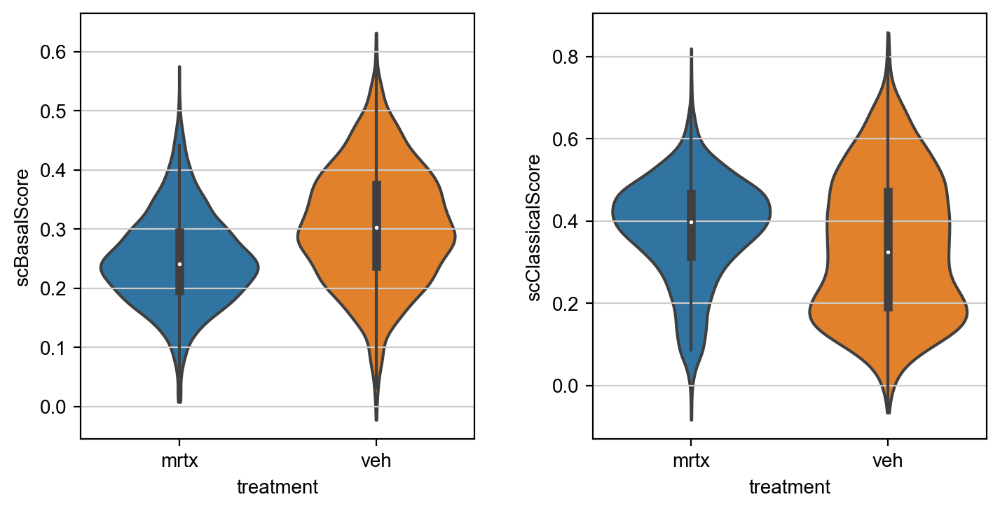

In [16]:
sc.pl.violin(adata,  keys=["scBasalScore", "scClassicalScore"], groupby="treatment",  inner = "box", stripplot=False)

In [17]:
adata

AnnData object with n_obs × n_vars = 6782 × 1589
    obs: 'BFP', 'CLuc', 'CreER', 'DTR', 'EGFP', 'GLuc', 'luciferase', 'mScarlet', 'tdTomato', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'pct_counts_mt', 'most_likely_hypothesis', 'cluster_feature', 'negative_hypothesis_probability', 'singlet_hypothesis_probability', 'doublet_hypothesis_probability', 'Classification', 'GMM', 'treatment', 'leiden', 'tdT+', 'EGFP+', 'tumor', 'scBasalScore', 'scClassicalScore', 'EMTScore', 'cellState', 'decoupler', 'zsig'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'mt'
    uns: 'EGFP+_colors', 'GMM_colors', 'cellState_colors', 'decoupler_colors', 'dendrogram_leiden', 'hvg', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'rank_genes_groups', 'tdT+_colors', 'treatment_colors', 

In [22]:
alpha=0.01
trtBasal = adata[adata.obs.treatment=="mrtx"].obs["scBasalScore"]
vehBasal = adata[adata.obs.treatment=="veh"].obs["scBasalScore"]

u_statistic, p_value = stats.mannwhitneyu(vehBasal,trtBasal, alternative="greater")
if p_value < alpha:
    print("Reject the null hypothesis: The means are significantly different.")
else:
    print("Fail to reject the null hypothesis: No significant difference detected.")

print(f"mannwhitneyu’s u-statistic: {u_statistic:.4f}, p-value: {p_value:.4f}")

Reject the null hypothesis: The means are significantly different.
mannwhitneyu’s u-statistic: 7760932.0000, p-value: 0.0000


In [23]:
alpha=0.01
trtClass = adata[adata.obs.treatment=="mrtx"].obs["scClassicalScore"]
vehClass = adata[adata.obs.treatment=="veh"].obs["scClassicalScore"]

u_statistic, p_value = stats.mannwhitneyu(trtClass,vehClass, alternative="greater")
if p_value < alpha:
    print("Reject the null hypothesis: The means are significantly different.")
else:
    print("Fail to reject the null hypothesis: No significant difference detected.")

print(f"mannwhitneyu’s u-statistic: {u_statistic:.4f}, p-value: {p_value:.4f}")

Reject the null hypothesis: The means are significantly different.
mannwhitneyu’s u-statistic: 6706182.0000, p-value: 0.0000


In [ ]:
def mannwhitScore(adata, obsLabel, cellstate1, cellState2, score, alt="greater"):

    return stats.mannwhitneyu(adata[adata.obs[obsLabel]==cellstate1].obs[score],
                              adata[adata.obs[obsLabel]==cellstate1].obs[score], alternative=alt)